In [39]:
import numpy as np
from matplotlib import pyplot as plt
from tqdm import tqdm
import os

from PIL import Image

from typing import Callable, Tuple

# Columnwise shifted pictures 

* Divide a picture into roughly equal blocks of columns. Each process takes its own block. The number of columns $N$ is not equal to the number of processes $n_p$, i.e., $N \ne n_p$ in general.
* Create $N$ new pictures by cyclically shifting the columns of pixels. E.g., for $N = 3 $: $[c_0, c_1, c_2] \rightarrow [c_2, c_0, c_1] \rightarrow [c_1, c_2, c_0]$

## Single process implementation

In [55]:
def plot_image(image: np.ndarray, figsize: Tuple[int]=(10, 10)):
    fig, ax = plt.subplots(1, 1, figsize=figsize)
    
    ax.imshow(image)
    ax.set_xticks([])
    ax.set_yticks([])
    
    return fig

In [56]:
img = plt.imread('stripes.jpg')

/home/sanityseeker/.local/lib/python3.7/site-packages/matplotlib/figure.py:445: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  % get_backend())


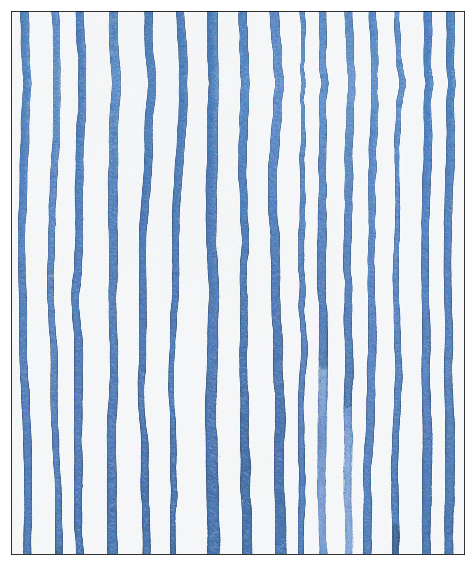

In [57]:
plot_image(img).show()

In [58]:
def do_column_shift(img: np.ndarray, shift_size: int=1) -> np.ndarray:
    return np.roll(img, 1, axis=1)

In [59]:
frames = []
shifted = img.copy()
for i in tqdm(range(1000)):
    shifted = do_column_shift(shifted)
    if i % 20 == 0:
        frames.append(shifted)

100%|██████████| 1000/1000 [00:00<00:00, 1946.10it/s]


## Single process gif

 40%|████      | 20/50 [00:02<00:03,  8.14it/s]/home/sanityseeker/.local/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
100%|██████████| 50/50 [00:06<00:00,  7.97it/s]


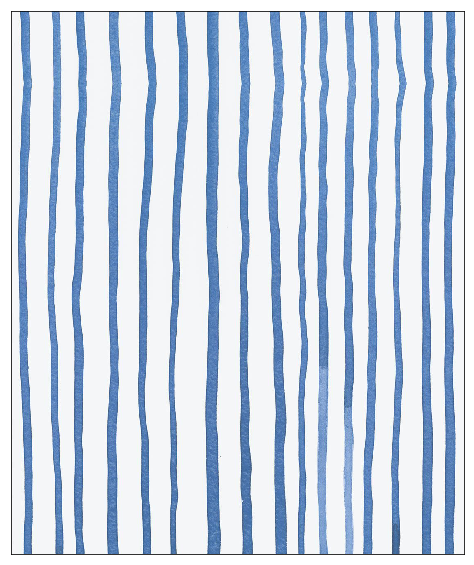

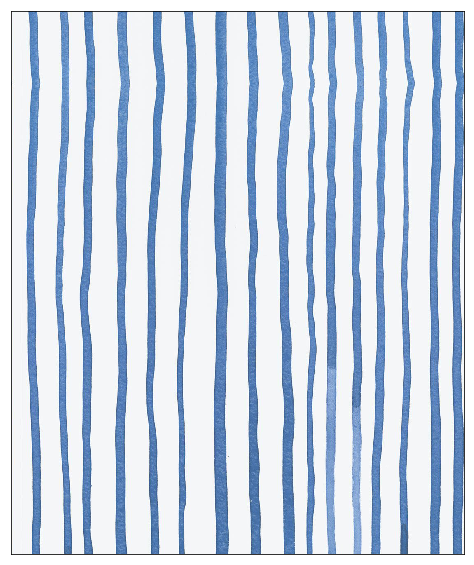

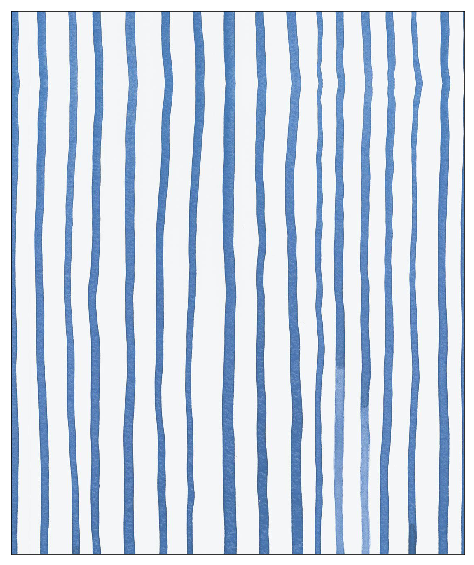

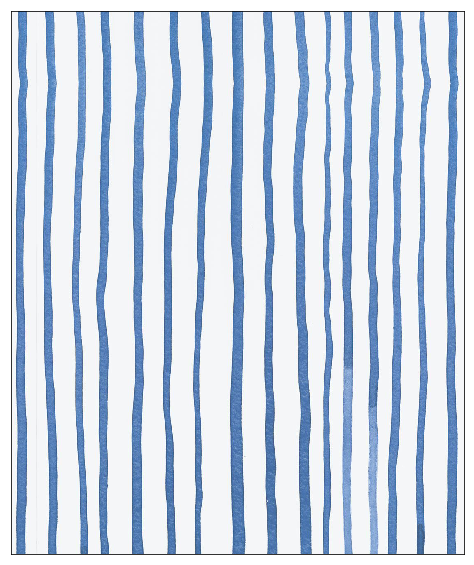

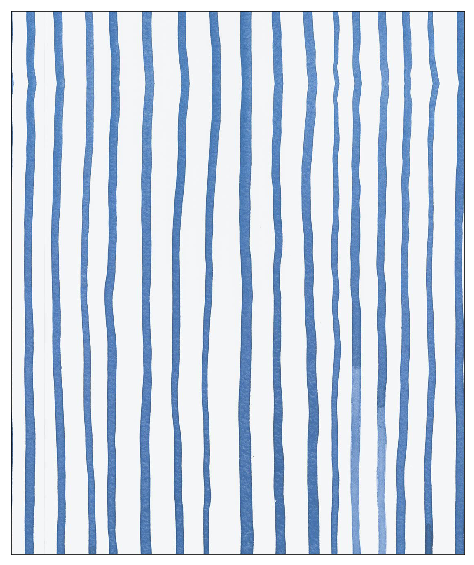

...

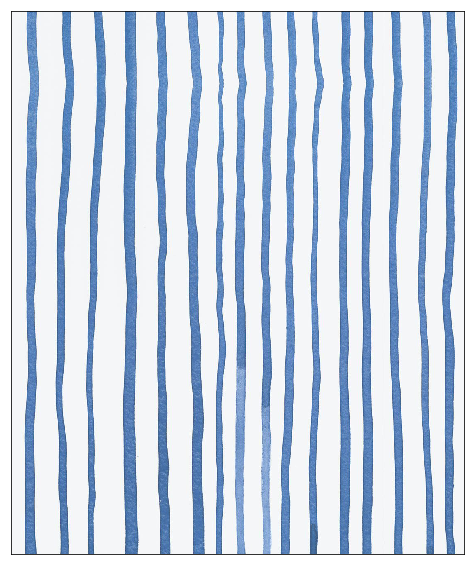

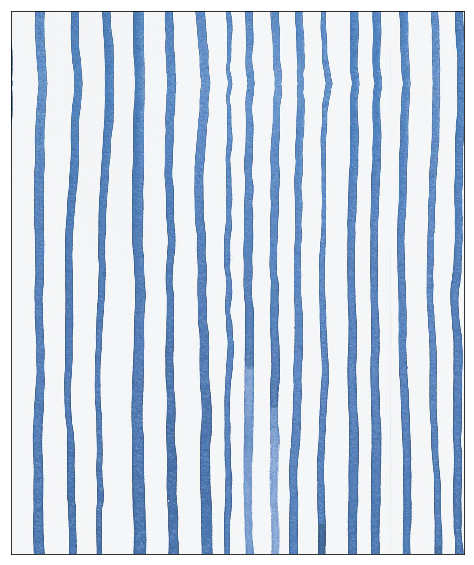

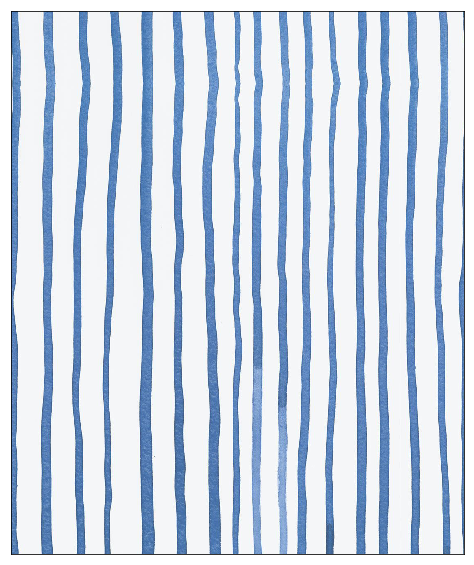

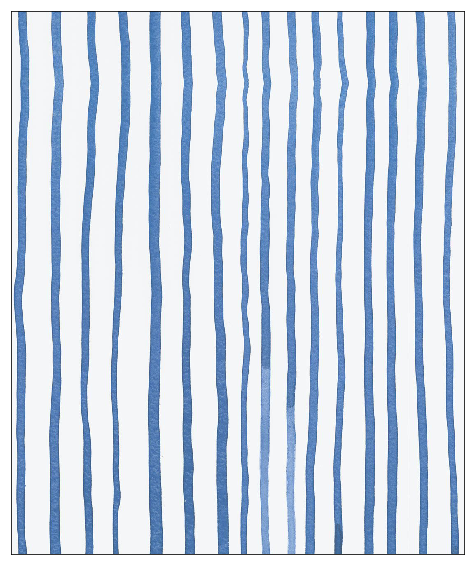

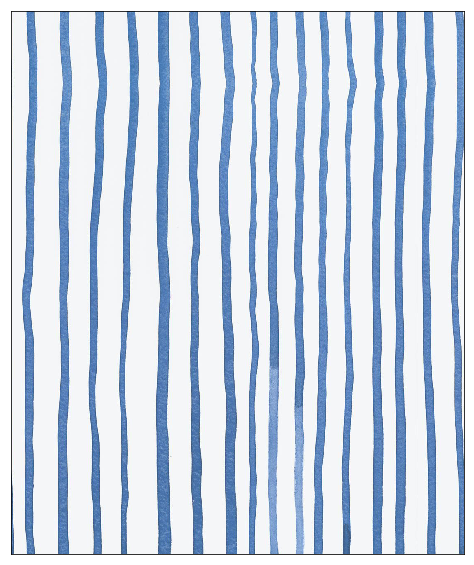

In [297]:
import imageio

img_path = 'shifted_images'
os.makedirs(img_path, exist_ok=True)

for i, image in enumerate(tqdm(frames)):
    image = plot_image(image)
    image.savefig(os.path.join(img_path, f'{i}.png'))

In [61]:
gif_images = []
for i in range(len(frames)):
    gif_images.append(imageio.imread(os.path.join(img_path, f'{i}.png')))
    
imageio.mimsave('shift.gif', gif_images, duration=0.15)

![](shift.gif)

## Show speedup

In [328]:
if os.path.exists('times'):
    os.remove('times')
for i in tqdm(range(1, 9)):
    os.system(f'mpirun -n {i} python mpi_picture_shift.py --return_time -n_iterations=10000')

100%|██████████| 8/8 [00:28<00:00,  1.50s/it]


In [323]:
proc_times = {}

with open('times', 'r') as f:
    for line in f.readlines():
        proc, times = line.strip().split()
        proc_times[int(proc)] = float(times)

initial_time = proc_times[1]
proc_times

{1: 4.7468,
 2: 3.5186,
 3: 3.9393,
 4: 3.8493,
 5: 5.0826,
 6: 5.6964,
 7: 6.7916,
 8: 14.4769}

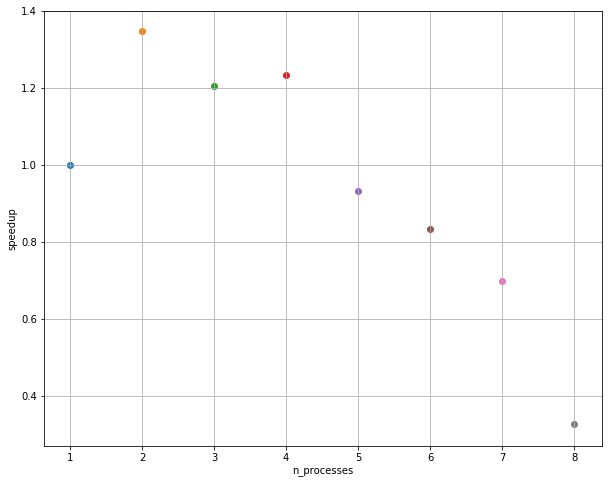

In [324]:
fig, ax = plt.subplots(1, 1, figsize=(10, 8))

for n_proc, time in proc_times.items():
    ax.scatter(n_proc, initial_time / time)

ax.grid()
ax.set_xlabel('n_processes')
ax.set_ylabel('speedup')

fig.savefig('speedup.png')

Well, that was not expected. I guess, the reason might be in the overhead on sending and receiving data

## Memory

In [330]:
if os.path.exists('memories'):
    os.remove('memories')
for i in tqdm(range(1, 9)):
    os.system(f'mpirun -n {i} python mpi_picture_shift.py --return_memory -n_iterations=1000')

100%|██████████| 8/8 [00:21<00:00,  3.44s/it]


In [286]:
proc_mem = {}

with open('memories', 'r') as f:
    for line in f.readlines():
        proc, mems = line.strip().split()
        proc_mem[int(proc)] = float(mems)

proc_mem

{1: 13.7233,
 2: 9.3839,
 3: 9.3655,
 4: 9.3655,
 5: 9.3655,
 6: 9.3655,
 7: 9.3655,
 8: 9.3655}

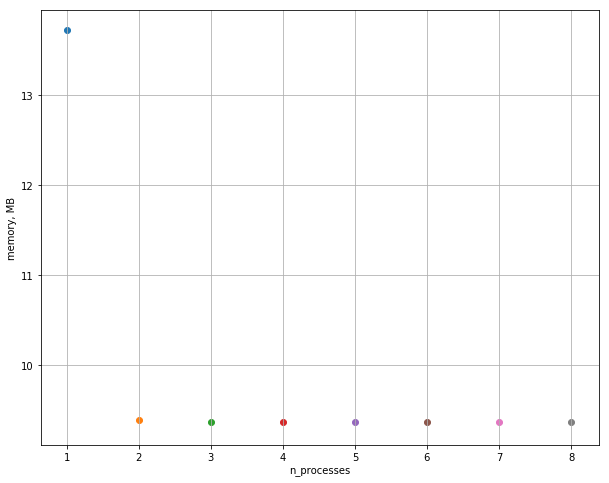

In [281]:
fig, ax = plt.subplots(1, 1, figsize=(10, 8))

for n_proc, mem in proc_mem.items():
    ax.scatter(n_proc, mem)

ax.grid()
ax.set_xlabel('n_processes')
ax.set_ylabel('memory, MB')

fig.savefig('memory.png')

## Sanity check

Show that in multiprocessing gif is calculated correctly

In [325]:
test_n_processes = 4
n_iterations = 1000
images_path = 'shifted_images_mpi'
gif_images_path = os.path.join(images_path, 'gif')

os.system(f'mpirun -n {test_n_processes} python mpi_picture_shift.py --compute_gif_files -n_iterations={n_iterations}')

0

100%|██████████| 50/50 [00:07<00:00,  6.95it/s]


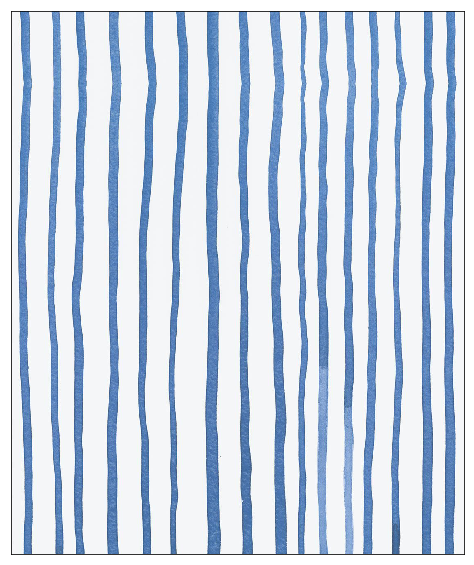

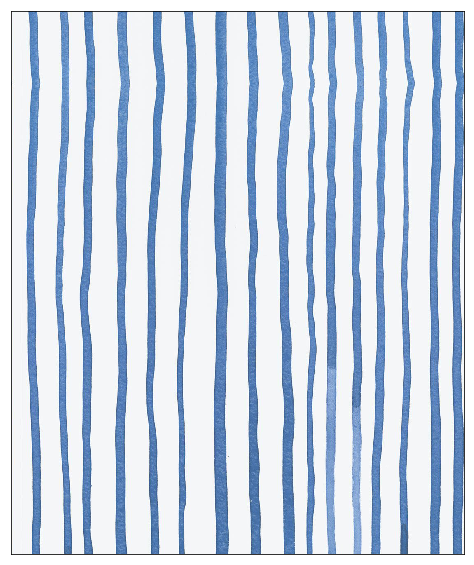

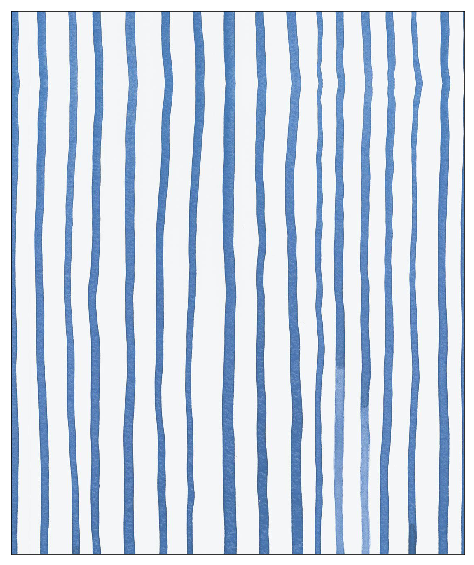

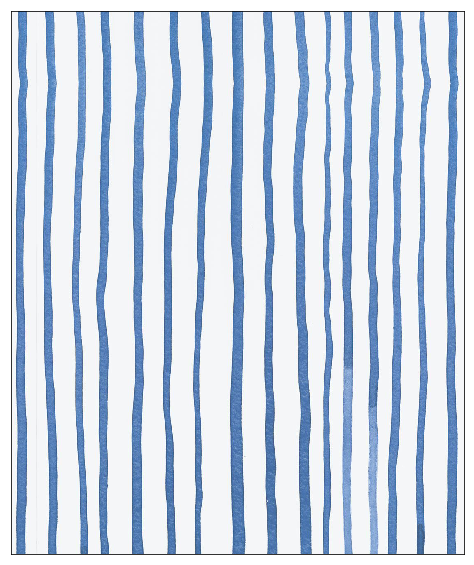

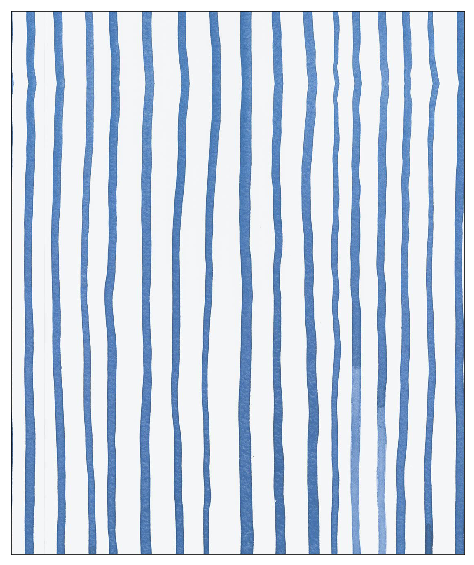

...

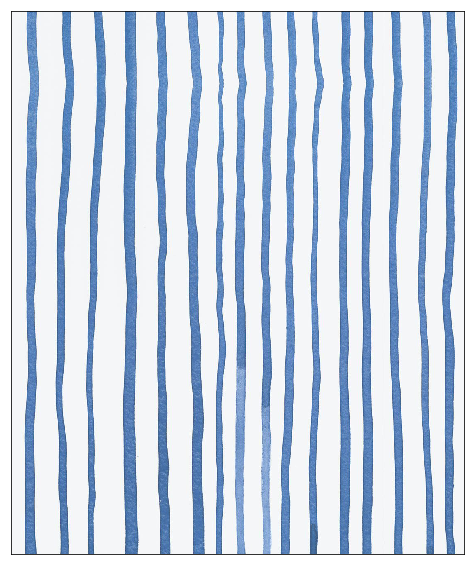

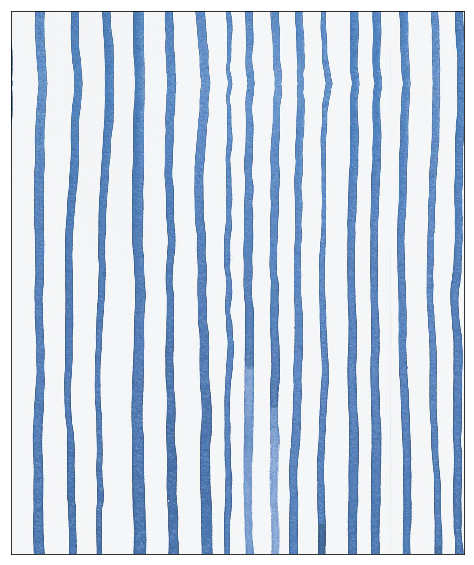

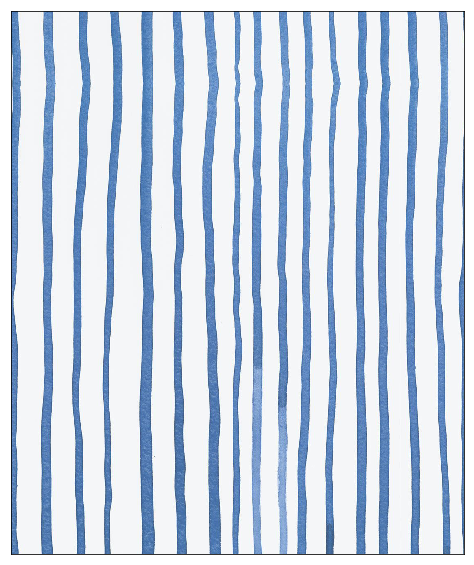

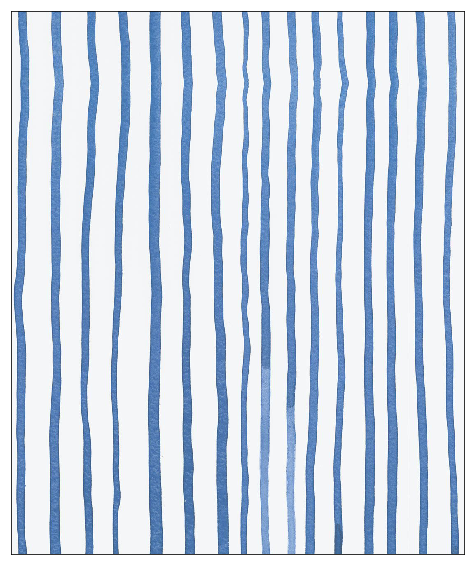

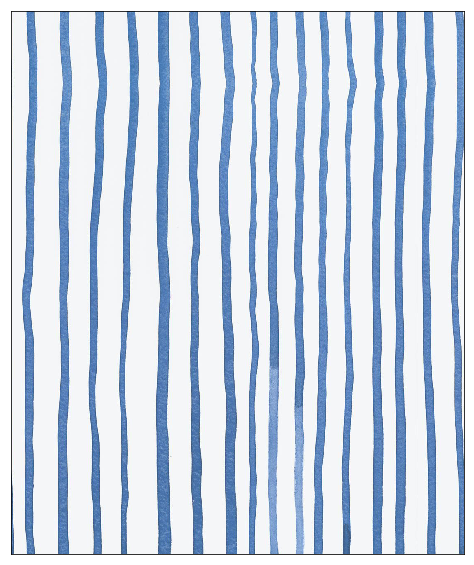

In [326]:
border_values = list(range(0, img.shape[1], img.shape[1] // test_n_processes + 1)) + [img.shape[1]]

gif_images = []

if os.path.exists(gif_images_path):
    os.system(f'rm -rf {gif_images_path}/*')
else:
    os.makedirs(gif_images_path)

for i in tqdm(np.arange(0, n_iterations, 20)):
    if i % 20 == 0:
        parts = [np.load(os.path.join(images_path, f'{j}_{i}.npy')) for j in range(test_n_processes)]
        
        joined_img = parts[0]
        for j, part in enumerate(parts[1:-1], start=1):
            joined_img = np.hstack((joined_img[:, :border_values[j], ...], part[:, 1:border_values[j + 1], ...]))
        
        joined_img = np.hstack((joined_img, parts[-1][:, 1:, ...]))
        assert joined_img.shape == img.shape
        
        joined_img = plot_image(joined_img)
        joined_img.savefig(os.path.join(gif_images_path, f'{i}.png'))
        
        gif_images.append(imageio.imread(os.path.join(gif_images_path, f'{i}.png')))
    
imageio.mimsave('shift_mpi.gif', gif_images, duration=0.15)

![](shift_mpi.gif)

Looks nice

# TEST

In [208]:
def create_grid(size: int, bw_ratio: float):
    grid = np.zeros((size**2))
    grid[:int(size**2 * bw_ratio)] += 255
    grid = grid.reshape((size, size))
    np.random.shuffle(grid)
    return grid.astype(np.uint8)

In [289]:
a = create_grid(5, 0.5)
np.save('test', a)

In [290]:
SIZE = 2
os.system(f'mpirun -n {SIZE} python mpi_picture_shift.py -n_iterations=1000 --save_processes_parts -image_path=test.npy')

0

In [291]:
step = a.shape[1] // SIZE + 1
border_values = list(range(0, a.shape[1], step)) + [a.shape[1]]
border_values

[0, 3, 5]

In [292]:
first_half = np.load('0.npy')
second_half = np.load('1.npy')
new_img = np.hstack((first_half[:, :border_values[1], ...], second_half[:, 1:, ...]))
new_img

array([[  0,   0,   0,   0,   0],
       [255, 255, 255, 255, 255],
       [  0,   0,   0,   0,   0],
       [255, 255, 255, 255, 255],
       [255, 255,   0,   0,   0]], dtype=uint8)

In [293]:
shifted = a.copy()
for i in range(1000):
    do_column_shift(a)

In [294]:
assert np.allclose(new_img, shifted)